In [114]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.metrics import accuracy_score, classification_report, f1_score, confusion_matrix, pairwise_distances
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor, NearestNeighbors
from sklearn.decomposition import PCA, KernelPCA
from sklearn.manifold import TSNE
from sklearn.ensemble import IsolationForest
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import RFECV

from imblearn.under_sampling import TomekLinks, RepeatedEditedNearestNeighbours
from imblearn.over_sampling import SMOTE
from imblearn.combine import SMOTETomek

from scipy.stats import gaussian_kde, wilcoxon, mannwhitneyu
import scipy.stats as stats

import plotly.express as px
import plotly.graph_objects as go
from ipywidgets import widgets, interact
import plotly.io as pio
pio.renderers.default='notebook'

import warnings
warnings.filterwarnings("ignore")

## 1. Importing dataset

In [115]:
df = pd.read_excel('../Data/DryBeanDataSet.xlsx')

In [116]:
df.shape

(13611, 22)

### Splitting data into training and test set

In [117]:
missing_value_mask = (df=='?').any(axis=1)

In [118]:
missing_value_dataset = df[missing_value_mask]
without_missing_value_dataset = df[~missing_value_mask]

In [119]:
missing_value_dataset.shape

(52, 22)

In [120]:
without_missing_value_dataset.shape

(13559, 22)

In [121]:
train_df, test_df = train_test_split(without_missing_value_dataset, random_state=42, test_size=0.2)

In [122]:
df = pd.concat([train_df, missing_value_dataset])

In [123]:
df.shape

(10899, 22)

In [124]:
test_df.shape

(2712, 22)

# EDA and Data Quality Issues
 TODO: Explain Sort Order Variable

## 2. Characterising features of dataset in table

In [125]:
df.shape

(10899, 22)

In [126]:
df.head(3)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,Constantness,EquivDiameter,Colour,...,roundness,Compactness,ShapeFactor1,ShapeFactor2,ShapeFactor3,ShapeFactor4,ShapeFactor5,ShapeFactor6,Class,Sort order
3479,43159,782.565,282.242410,195.095726,1.446687,0.722630,43661,1,234.417887,brown,...,0.885606,0.830555,0.006540,0.001920,0.689822,0.953606,0.997956,54.167078,SIRA,0.639764
11938,37826,704.225,242.586215,198.865740,1.219849,0.572688,38170,0,219.457420,green,...,0.958468,0.904657,0.006413,0.002650,0.818405,2.024259,0.998331,33.627907,SEKER,0.991965
6110,30180,639.114,237.364208,162.351296,1.462041,0.729505,30533,1,196.026451,black,...,0.928480,0.825847,0.007865,0.002257,0.682023,1.591614,0.997145,93.600673,DERMASON,0.223247


In [127]:
numerical_features = ['Area', 'Perimeter', 'MajorAxisLength', 'MinorAxisLength',
       'AspectRation', 'Eccentricity', 'ConvexArea',
       'EquivDiameter', 'Extent', 'Solidity', 'roundness',
       'Compactness', 'ShapeFactor1', 'ShapeFactor2', 'ShapeFactor3',
       'ShapeFactor4', 'ShapeFactor5', 'ShapeFactor6']
categorical_features = ['Constantness', 'Colour', 'Class']

numerical_stats = pd.DataFrame(columns=['Feature', 'Count', '% Missing Values', 'Cardinality', 'Min', '1st Qrt', 'Mean', 'Median', '3rd Qrt', 'Max', 'Std Dev', 'Potential Outliers'])
categorical_stats = pd.DataFrame(columns=['Feature', 'Count', '% Missing Values', 'Cardinality', 'Mode', 'Mode Freq', 'Mode %', '2nd Mode', '2nd Mode Freq', '2nd Mode %'])

In [128]:
def find_potential_outliers_IQR(series):
    Q1 = series.quantile(0.25)
    Q3 = series.quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    return ((series < lower_bound) | (series > upper_bound)).sum()

def find_potential_outliers(series):
    z_scores = stats.zscore(series)
    threshold = 3
    return (abs(z_scores) > threshold).sum()

In [129]:
for column in numerical_features:
    series = pd.to_numeric(df[column].replace('?', np.nan), errors='coerce')
    row = pd.DataFrame({
        'Feature': [column],
        'Count': [series.count()],
        '% Missing Values': [series.isna().mean() * 100],
        'Cardinality': [series.nunique()],
        'Min': [series.min()],
        '1st Qrt': [series.quantile(0.25)],
        'Mean': [series.mean()],
        'Median': [series.median()],
        '3rd Qrt': [series.quantile(0.75)],
        'Max': [series.max()],
        'Std Dev': [series.std()],
        'Potential Outliers': [find_potential_outliers(series)]
    })
    numerical_stats = pd.concat([numerical_stats, row], ignore_index=True)

In [130]:
for column in categorical_features:
    series = df[column].replace('?', np.nan)
    mode_freqs = series.value_counts()
    mode = mode_freqs.index[0]
    mode_freq = mode_freqs.iloc[0]
    mode_pct = (mode_freq / len(series)) * 100
    second_mode = mode_freqs.index[1] if len(mode_freqs) > 1 else None
    second_mode_freq = mode_freqs.iloc[1] if len(mode_freqs) > 1 else None
    second_mode_pct = (second_mode_freq / len(series)) * 100 if second_mode_freq is not None else None
    
    row = pd.DataFrame({
        'Feature': [column],
        'Count': [series.count()],
        '% Missing Values': [series.isna().mean() * 100],
        'Cardinality': [series.nunique()],
        'Mode': [mode],
        'Mode Freq': [mode_freq],
        'Mode %': [mode_pct],
        '2nd Mode': [second_mode],
        '2nd Mode Freq': [second_mode_freq],
        '2nd Mode %': [second_mode_pct]
    })
    categorical_stats = pd.concat([categorical_stats, row], ignore_index=True)

In [131]:
numerical_stats

,Feature,Count,% Missing Values,Cardinality,Min,1st Qrt,Mean,Median,3rd Qrt,Max,Std Dev,Potential Outliers
0,Area,10899,0.000000,9851,20420,36317.000000,53091.364621,44722.000000,61479.500000,254616,29320.758400,385
1,Perimeter,10899,0.000000,10743,524.736,703.327000,855.722125,795.665000,977.995500,1985.37,214.429304,321
2,MajorAxisLength,10899,0.000000,10858,183.601165,253.172668,320.276412,297.629702,376.554861,738.860153,85.723683,254
3,MinorAxisLength,10899,0.000000,10858,122.512653,175.781493,202.358895,192.480217,217.507143,460.198497,44.995098,402
4,AspectRation,10899,0.000000,10858,1.024868,1.430616,1.583266,1.551798,1.708684,2.430306,0.247107,10
5,Eccentricity,10899,0.000000,10858,0.218951,0.715122,0.750741,0.764677,0.810856,0.911423,0.092478,104
6,ConvexArea,10899,0.000000,9918,20684,36695.000000,53812.220754,45279.000000,62439.500000,263261,29777.600159,385
7,EquivDiameter,10899,0.000000,9851,0.161417,215.035440,531.896151,238.624850,279.800494,3014441.238914,28872.953609,1
8,Extent,10893,0.055051,10847,0.555315,0.718876,0.749948,0.759980,0.786882,0.866195,0.048995,0
9,Solidity,10899,0.000000,10846,0.919246,0.985633,0.987151,0.988286,0.990029,0.994378,0.004638,189


In [132]:
categorical_stats

,Feature,Count,% Missing Values,Cardinality,Mode,Mode Freq,Mode %,2nd Mode,2nd Mode Freq,2nd Mode %
0,Constantness,10899,0.000000,2,1,9863,90.494541,0,1036,9.505459
1,Colour,10893,0.055051,4,brown,4904,44.994954,black,2813,25.809707
2,Class,10882,0.155978,7,DERMASON,2814,25.818882,SIRA,2105,19.313699


## 3. Exploration of dataset to identify data quality issues

In [133]:
new_df = df.copy().drop('Sort order', axis=1)

In [134]:
new_df.replace('?', np.nan, inplace=True)

In [135]:
def plot_distribution(feature, show_density):
    plt.figure(figsize=(10, 6))
    
    if new_df[feature].dtype == 'object':
        sns.countplot(x=new_df[feature])
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Count')
    else:
        sns.histplot(new_df[feature].dropna(), kde=show_density, bins=50)
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Density' if show_density else 'Count')
        
    plt.show()

feature_selector = widgets.Dropdown(
    options=new_df.columns,
    description='Feature:',
    disabled=False,
)

density_checkbox = widgets.Checkbox(
    value=False,
    description='Show Density',
    disabled=False
)

interact(plot_distribution, feature=feature_selector, show_density=density_checkbox)

interactive(children=(Dropdown(description='Feature:', options=('Area', 'Perimeter', 'MajorAxisLength', 'Minor…

<function __main__.plot_distribution(feature, show_density)>

In [136]:
def plot_distribution(feature, show_density):
    plt.figure(figsize=(10, 6))
    
    if new_df[feature].dtype == 'object':
        sns.countplot(x=new_df[feature])
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Count')
    else:
        ax_hist = sns.histplot(new_df[feature].dropna(), bins=50, kde=False, color='lightblue')
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Count')

        if show_density:
            ax_density = ax_hist.twinx()
            for cls in new_df['Class'].unique():
                sns.kdeplot(new_df[new_df['Class'] == cls][feature].dropna(), ax=ax_density, label=f'Class {cls}')
            
            ax_density.set_ylabel('Density')
            ax_density.legend(title='Class')

    plt.show()

feature_selector = widgets.Dropdown(
    options=new_df.columns,
    description='Feature:',
    disabled=False,
)

density_checkbox = widgets.Checkbox(
    value=False,
    description='Show Density',
    disabled=False
)

interact(plot_distribution, feature=feature_selector, show_density=density_checkbox)

interactive(children=(Dropdown(description='Feature:', options=('Area', 'Perimeter', 'MajorAxisLength', 'Minor…

<function __main__.plot_distribution(feature, show_density)>

## Outliers

#### EquivDiameter
Removing outliers from EquivDiameter: see previous plot for reasoning for this variable

In [137]:
Q1 = new_df['EquivDiameter'].quantile(0.25)
Q3 = new_df['EquivDiameter'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 5 * IQR
upper_bound = Q3 + 5 * IQR
outliers = new_df[((new_df['EquivDiameter'] < lower_bound) | (new_df['EquivDiameter'] > upper_bound))]
print(outliers.shape)
filtered_equiv_diameter = new_df[((new_df['EquivDiameter'] > lower_bound) & (new_df['EquivDiameter'] < upper_bound))]

(2, 21)


In [138]:
round(filtered_equiv_diameter['EquivDiameter'].describe())

count    10897.0
mean       253.0
std         59.0
min          0.0
25%        215.0
50%        239.0
75%        280.0
max        569.0
Name: EquivDiameter, dtype: float64

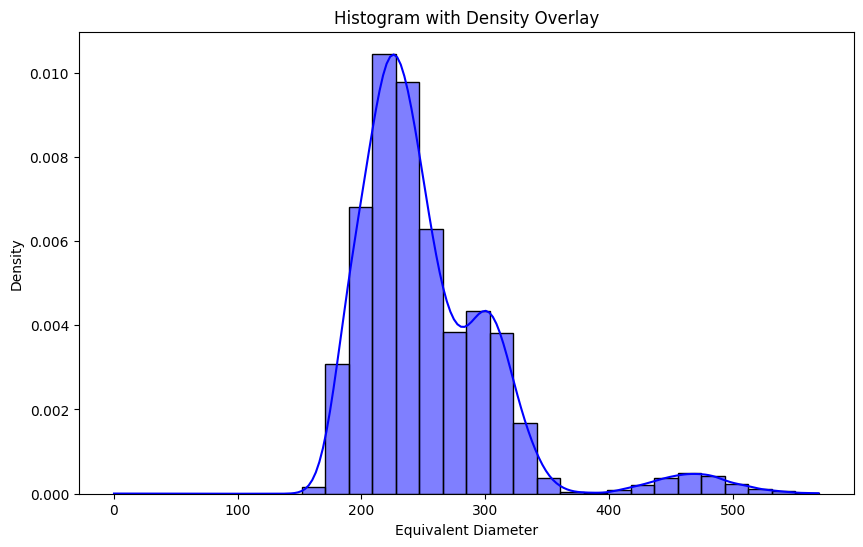

In [139]:
plt.figure(figsize=(10, 6))

sns.histplot(filtered_equiv_diameter['EquivDiameter'], kde=True, bins=30, color='blue', stat='density', edgecolor='black')

plt.title('Histogram with Density Overlay')
plt.xlabel('Equivalent Diameter')
plt.ylabel('Density')

plt.show()

For the Equivalent Diameter, there are 2 extreme outliers. These values must be carefully addressed, i.e. carefully decided what to do with these outliers.

In [140]:
for feature in categorical_features:
    print(f'feature: {new_df[feature].value_counts()}')

feature: Constantness
1    9863
0    1036
Name: count, dtype: int64
feature: Colour
brown    4904
black    2813
green    1635
white    1541
Name: count, dtype: int64
feature: Class
DERMASON    2814
SIRA        2105
SEKER       1637
HOROZ       1542
CALI        1307
BARBUNYA    1063
BOMBAY       414
Name: count, dtype: int64


In [141]:
outliers[categorical_features]

,Constantness,Colour,Class
2762,1,brown,SIRA
4780,1,brown,BARBUNYA


These outliers are both not minority class values. Therefore they are dropped from the dataset.

#### Removing Outliers

In [142]:
new_df_outliers_removed = new_df.drop(outliers.index, axis=0)

In [143]:
new_df_outliers_removed.shape

(10897, 21)

## Transforming Categorical Features

In [144]:
new_df = new_df_outliers_removed.replace('?', np.nan)

In [145]:
le = LabelEncoder()
le.fit(new_df['Class'].dropna())
new_df['Class'] = new_df['Class'].map(lambda x:le.transform([x])[0] if pd.notna(x) else np.nan)

In [146]:
new_df = pd.get_dummies(new_df, columns=['Colour'], dtype='int', dummy_na=True)

In [147]:
new_df_outliers_removed[['Class', 'Colour']].head(4)

,Class,Colour
3479,SIRA,brown
11938,SEKER,green
6110,DERMASON,black
3014,SIRA,brown


In [148]:
new_df.head(3)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,Constantness,EquivDiameter,Extent,...,ShapeFactor3,ShapeFactor4,ShapeFactor5,ShapeFactor6,Class,Colour_black,Colour_brown,Colour_green,Colour_white,Colour_nan
3479,43159,782.565,282.242410,195.095726,1.446687,0.722630,43661,1,234.417887,0.753251,...,0.689822,0.953606,0.997956,54.167078,6.0,0,1,0,0,0
11938,37826,704.225,242.586215,198.865740,1.219849,0.572688,38170,0,219.457420,0.764532,...,0.818405,2.024259,0.998331,33.627907,5.0,0,0,1,0,0
6110,30180,639.114,237.364208,162.351296,1.462041,0.729505,30533,1,196.026451,0.745553,...,0.682023,1.591614,0.997145,93.600673,3.0,1,0,0,0,0


In [149]:
new_df.shape

(10897, 25)

# OPTIONAL CODE!!!!

### Isolation Forest for Outlier Detection

In [ ]:
rows_with_missing_values = new_df[new_df.isnull().any(axis=1)]

filtered_df = new_df.dropna()

iso_forest = IsolationForest(contamination=0.05, random_state=42)
iso_forest.fit(filtered_df.drop(columns=['Colour_nan']))

In [ ]:
filtered_df['is_inlier'] = iso_forest.predict(filtered_df.drop(columns=['Colour_nan']))

inliers = filtered_df[filtered_df['is_inlier'] == 1].index

new_df_filtered = new_df.loc[inliers]

In [ ]:
new_df_outliers_removed_ = pd.concat([new_df_filtered, rows_with_missing_values], axis=0)
new_df_outliers_removed_.reset_index(drop=True, inplace=True)

new_df = new_df_outliers_removed_.copy()
print(f"Final dataset shape after re-adding missing values: {new_df.shape}")

In [ ]:
def plot_distribution(feature, show_density):
    plt.figure(figsize=(10, 6))
    
    if new_df[feature].dtype == 'object':
        sns.countplot(x=new_df[feature])
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Count')
    else:
        ax_hist = sns.histplot(new_df[feature].dropna(), bins=50, kde=False, color='lightblue')
        plt.title(f'Distribution of {feature}')
        plt.xlabel(feature)
        plt.ylabel('Count')

        if show_density:
            ax_density = ax_hist.twinx()  
            for cls in new_df['Class'].unique():
                sns.kdeplot(new_df[new_df['Class'] == cls][feature].dropna(), ax=ax_density, label=f'Class {cls}')
            
            ax_density.set_ylabel('Density')
            ax_density.legend(title='Class')

    plt.show()

feature_selector = widgets.Dropdown(
    options=new_df.columns,
    description='Feature:',
    disabled=False,
)

density_checkbox = widgets.Checkbox(
    value=False,
    description='Show Density',
    disabled=False
)

interact(plot_distribution, feature=feature_selector, show_density=density_checkbox)

## Missing Values

In [150]:
missing_vals = new_df.isna().sum()
missing_vals['Colour'] = new_df['Colour_nan'].sum()

In [151]:
missing_vals.sort_values(ascending=False).head(6)

Compactness     18
Class           17
Colour           6
Extent           6
ShapeFactor6     5
ShapeFactor2     0
dtype: int64

In [152]:
missing_mask = (new_df['Colour_nan']==1) | new_df.isna().any(axis=1)

In [153]:
df_with_missing = new_df[missing_mask]
df_without_missing = new_df[~missing_mask]

In [154]:
df_with_missing.shape

(52, 25)

In [155]:
df_without_missing.shape

(10845, 25)

In [156]:
df_without_missing.drop('Colour_nan', axis=1, inplace=True)

### Trying to find clusters in data to impute missing values

In [157]:
df_without_missing.head(3)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,Constantness,EquivDiameter,Extent,...,ShapeFactor2,ShapeFactor3,ShapeFactor4,ShapeFactor5,ShapeFactor6,Class,Colour_black,Colour_brown,Colour_green,Colour_white
3479,43159,782.565,282.242410,195.095726,1.446687,0.722630,43661,1,234.417887,0.753251,...,0.001920,0.689822,0.953606,0.997956,54.167078,6.0,0,1,0,0
11938,37826,704.225,242.586215,198.865740,1.219849,0.572688,38170,0,219.457420,0.764532,...,0.002650,0.818405,2.024259,0.998331,33.627907,5.0,0,0,1,0
6110,30180,639.114,237.364208,162.351296,1.462041,0.729505,30533,1,196.026451,0.745553,...,0.002257,0.682023,1.591614,0.997145,93.600673,3.0,1,0,0,0


# Class

In [158]:
df_without_missing['Class'].value_counts()

Class
3.0    2807
6.0    2102
5.0    1629
4.0    1532
2.0    1302
0.0    1062
1.0     411
Name: count, dtype: int64

In [159]:
feature_of_interest = 'Class'
X = df_without_missing.drop(feature_of_interest, axis=1)
y = df_without_missing[feature_of_interest]

X_test = df_with_missing[df_with_missing[feature_of_interest].isna()].drop(['Colour_nan',feature_of_interest], axis=1)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_test_scaled = scaler.transform(X_test)

<Axes: xlabel='PC1', ylabel='PC2'>

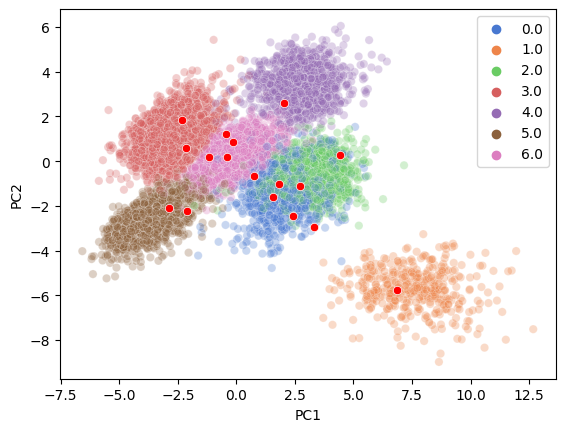

In [160]:
pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca[feature_of_interest] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)

sns.scatterplot(X_pca, x='PC1', y='PC2', hue=feature_of_interest, palette='muted', alpha=0.3)
sns.scatterplot(X_test_pca, x='PC1', y='PC2', c='red')

In [161]:
pca = PCA(n_components=3)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2', 'PC3'], index=X.index)
X_pca['Class'] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2', 'PC3'], index=X_test.index)
X_test_pca['Class'] = 'Test'

fig = px.scatter_3d(X_pca, x='PC1', y='PC2', z='PC3', color='Class', opacity=0.1)

fig.add_trace(go.Scatter3d(
    x=X_test_pca['PC1'],
    y=X_test_pca['PC2'],
    z=X_test_pca['PC3'],
    mode='markers',
    marker=dict(color='red', size=12),
    name='Test Points'
))

fig.update_layout(
    title='3D PCA Plot',
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3'
    )
)

fig.show()

Looking at the data in higher dimensions, we see that the points look to be dead center in certain clusters, but move further away in higher dimensions. There seems to be only a single observation belonging to the minority class' cluster, and so imputing the missing values in this case will only introduce noise to the data. The missing values for the class feature will therefore be dropped.

##### Using kNN to impute missing values

In [162]:
df_imputed_missing = df_with_missing.copy()

In [163]:
pca = PCA(n_components=5)
X_pca = pca.fit_transform(X_scaled)
X_missing_vals = pd.DataFrame(pca.transform(X_test_scaled), index=X_test.index)
X_pca.shape

(10845, 5)

In [164]:
X_missing_vals.index

Index([   6,  118,  436,  935, 1164, 1354, 1772, 2625, 2629, 2636, 2647, 2950,
       3141, 3200, 5622, 6952, 7903],
      dtype='int64')

In [165]:
df_imputed_missing.loc[X_missing_vals.index].head(3)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,Constantness,EquivDiameter,Extent,...,ShapeFactor3,ShapeFactor4,ShapeFactor5,ShapeFactor6,Class,Colour_black,Colour_brown,Colour_green,Colour_white,Colour_nan
6,44787,861.814,344.333903,166.179732,2.072057,0.875834,45406,1,238.798198,0.812920,...,0.480953,1.522022,0.996562,25.541389,NaN,0,1,0,0,0
118,42432,776.089,290.071712,187.172173,1.549759,0.763962,42908,1,232.435153,0.756957,...,0.642086,1.117294,0.995078,126.833659,NaN,0,1,0,0,0
436,41708,775.920,292.968805,181.913240,1.610486,0.783866,42212,1,230.443648,0.689218,...,0.618709,2.961417,0.996423,111.802204,NaN,0,1,0,0,0


In [166]:
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_pca, y)
imputed_vals = knn.predict(X_missing_vals)

##### Dropping these missing values

In [167]:
df_imputed_missing.shape

(52, 25)

In [168]:
#df_imputed_missing.loc[X_missing_vals.index, 'Class'] = imputed_vals
df_imputed_missing.drop(X_missing_vals.index, inplace=True)

In [169]:
df_imputed_missing.shape

(35, 25)

##### Evaluating Accuracy of imputation

In [170]:
feature_of_interest = 'Class'
X = df_without_missing.drop(feature_of_interest, axis=1)
y = df_without_missing[feature_of_interest]

X_test = df_with_missing.loc[X_missing_vals.index].drop(['Colour_nan',feature_of_interest], axis=1)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_test_scaled = scaler.transform(X_test)

<Axes: xlabel='PC1', ylabel='PC2'>

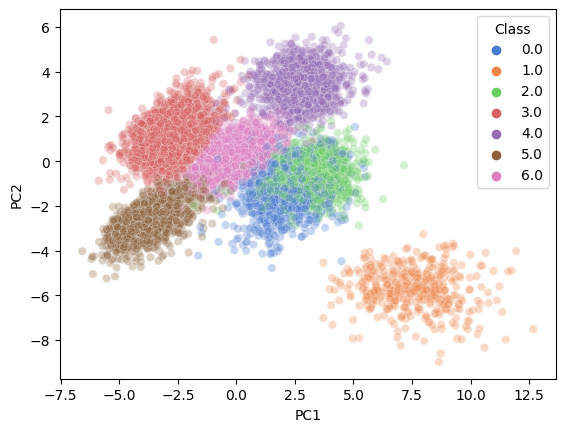

In [171]:
pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca[feature_of_interest] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)
X_test_pca[feature_of_interest] = df_imputed_missing[feature_of_interest]

sns.scatterplot(X_pca, x='PC1', y='PC2', hue=feature_of_interest, palette='muted', alpha=0.3)
sns.scatterplot(X_test_pca, x='PC1', y='PC2', hue=feature_of_interest, palette='muted', markers="x", legend=False)

In [172]:
df_without_missing['Class'].value_counts().sort_values()

Class
1.0     411
0.0    1062
2.0    1302
4.0    1532
5.0    1629
6.0    2102
3.0    2807
Name: count, dtype: int64

#### Conclusion: These noisy values will be removed in the noise removal section. The important thing is that the minority class missing values is imputed.

# Colour

In [173]:
def get_colour(row):
    if row['Colour_black'] == 1:
        return 'black'
    elif row['Colour_green'] == 1:
        return 'green'
    elif row['Colour_brown'] == 1:
        return 'brown'
    elif row['Colour_white'] == 1:
        return 'white'
    else:
        return np.nan

In [174]:
new_df_outliers_removed['Colour'].value_counts()

Colour
brown    4902
black    2813
green    1635
white    1541
Name: count, dtype: int64

In [175]:
features_of_interest = ['Colour_black','Colour_green', 'Colour_brown', 'Colour_white']
X = df_without_missing.drop(features_of_interest, axis=1)
y = df_without_missing.apply(get_colour, axis=1)

X_test = df_with_missing[df_with_missing['Colour_nan']==1].drop(features_of_interest, axis=1).drop('Colour_nan', axis=1)

<Axes: xlabel='PC1', ylabel='PC2'>

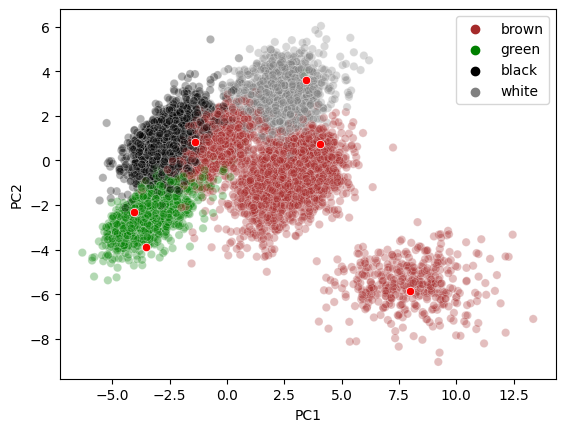

In [176]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_test_scaled = scaler.transform(X_test)

pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca['Colour'] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)

palette = {'black': 'black', 'green': 'green', 'brown': 'brown', 'white': 'grey'}

sns.scatterplot(X_pca, x='PC1', y='PC2', hue='Colour', palette=palette, alpha=0.3)
sns.scatterplot(X_test_pca, x='PC1', y='PC2', c='red')

In [177]:
pca = PCA(n_components=3)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2', 'PC3'], index=X.index)
X_pca['Colour'] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2', 'PC3'], index=X_test.index)
X_test_pca['Colour'] = 'Test'

fig = px.scatter_3d(X_pca, x='PC1', y='PC2', z='PC3', color='Colour', opacity=0.1)

fig.add_trace(go.Scatter3d(
    x=X_test_pca['PC1'],
    y=X_test_pca['PC2'],
    z=X_test_pca['PC3'],
    mode='markers',
    marker=dict(color='red', size=12),
    name='Test Points'
))

fig.update_layout(
    title='3D PCA Plot',
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3'
    )
)

fig.show()

##### Using kNN to impute missing values

In [178]:
df_imputed_missing['Colour'] = df['Colour']

In [179]:
df_imputed_missing.loc[X_test.index]

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,Constantness,EquivDiameter,Extent,...,ShapeFactor4,ShapeFactor5,ShapeFactor6,Class,Colour_black,Colour_brown,Colour_green,Colour_white,Colour_nan,Colour
1175,34757,686.779,231.229870,191.672033,1.206383,0.559361,35150,1,210.366316,0.786411,...,3.761237,0.998504,66.211289,5.0,0,0,0,0,1,?
2316,77276,1089.189,430.743098,231.192660,1.863135,0.843754,78423,0,313.673172,0.708616,...,1.868488,0.988012,119.901446,2.0,0,0,0,0,1,?
2317,45037,782.176,255.577468,224.642935,1.137705,0.476891,45554,0,239.463754,0.791164,...,2.829467,0.998767,60.357868,5.0,0,0,0,0,1,?
3003,58629,977.866,403.557192,186.801024,2.160359,0.886418,59488,1,273.219255,0.646762,...,3.120205,0.990235,102.859668,4.0,0,0,0,0,1,?
3149,175717,1585.869,593.695292,380.322431,1.561031,0.767873,178427,1,473.000881,0.802207,...,3.468364,0.990851,70.464488,1.0,0,0,0,0,1,?
3156,35545,720.761,261.663900,173.471912,1.508393,0.748657,36160,1,212.737631,0.745100,...,1.309971,0.997047,111.542321,3.0,0,0,0,0,1,?


In [180]:
pca = PCA(n_components=0.95)
X_pca = pca.fit_transform(X_scaled)
X_missing_vals = pd.DataFrame(pca.transform(X_test_scaled), index=X_test.index)
X_pca.shape

(10845, 8)

In [181]:
knn = KNeighborsClassifier(n_neighbors=3)
knn.fit(X_pca, y)
imputed_vals = knn.predict(X_missing_vals)

In [182]:
df_imputed_missing.loc[X_missing_vals.index, 'Colour'] = imputed_vals

##### Evaluating Accuracy of Imputation

<Axes: xlabel='PC1', ylabel='PC2'>

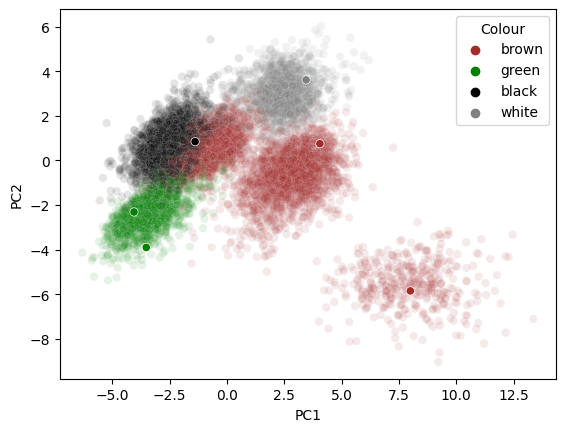

In [183]:
pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca['Colour'] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)
X_test_pca['Colour'] = df_imputed_missing['Colour']

palette = {'black': 'black', 'green': 'green', 'brown': 'brown', 'white': 'grey'}

sns.scatterplot(X_pca, x='PC1', y='PC2', hue='Colour', palette=palette, alpha=0.1)
sns.scatterplot(X_test_pca, x='PC1', y='PC2', hue='Colour', palette=palette, legend=False)

In [184]:
df_imputed_missing.drop(['Colour_black', 'Colour_brown', 'Colour_green', 'Colour_white', 'Colour_nan'], axis=1, inplace=True)

In [185]:
df_imputed_missing = pd.get_dummies(df_imputed_missing, columns=['Colour'], dtype='int')

# Compactness

<Axes: xlabel='PC1', ylabel='PC2'>

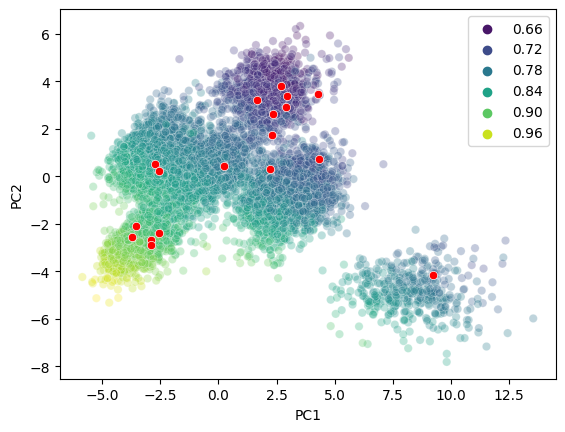

In [186]:
feature_of_interest = 'Compactness'
X = df_without_missing.drop(feature_of_interest, axis=1)
y = df_without_missing[feature_of_interest]

X_test = df_with_missing[df_with_missing[feature_of_interest].isna()].drop(['Colour_nan',feature_of_interest], axis=1)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_test_scaled = scaler.transform(X_test)

pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca[feature_of_interest] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)

sns.scatterplot(X_pca, x='PC1', y='PC2', hue=feature_of_interest, palette='viridis', alpha=0.3)
sns.scatterplot(X_test_pca, x='PC1', y='PC2', c='red')

##### Using kNN to impute Compactness

In [187]:
df_imputed_missing.loc[X_test.index]['Compactness']

104     NaN
484     NaN
788     NaN
902     NaN
1244    NaN
2042    NaN
2803    NaN
3982    NaN
5963    NaN
8813    NaN
9701    NaN
9702    NaN
9914    NaN
10015   NaN
10134   NaN
10234   NaN
10294   NaN
10325   NaN
Name: Compactness, dtype: float64

In [188]:
pca = PCA(n_components=0.95)
X_pca = pca.fit_transform(X_scaled)
X_missing_vals = pd.DataFrame(pca.transform(X_test_scaled), index=X_test.index)
X_pca.shape

(10845, 10)

In [189]:
knn = KNeighborsRegressor(n_neighbors=5)
knn.fit(X_pca, y)
imputed_vals = knn.predict(X_missing_vals)

##### Imputing with median

In [190]:
df_imputed_missing.loc[X_missing_vals.index, 'Compactness'] = imputed_vals
#df_imputed_missing.loc[X_missing_vals.index, 'Compactness'] = df_without_missing['Compactness'].median()

##### Evaluating accuracy of imputation

<Axes: xlabel='PC1', ylabel='PC2'>

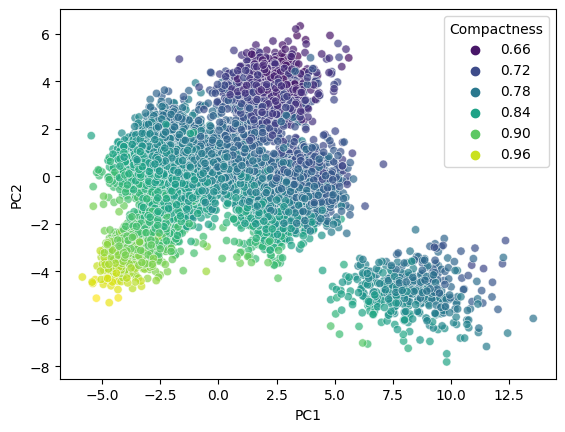

In [191]:
pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca['Compactness'] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)
X_test_pca['Compactness'] = df_imputed_missing['Compactness']

sns.scatterplot(pd.concat([X_pca,X_test_pca]), x='PC1', y='PC2', hue='Compactness', palette='viridis', alpha=0.7)

# Extent

<Axes: xlabel='PC1', ylabel='PC2'>

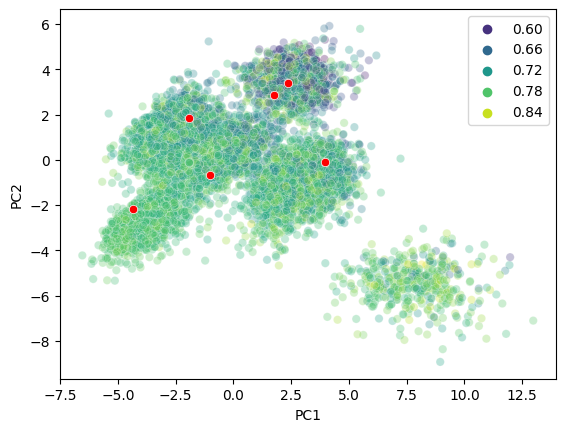

In [192]:
feature_of_interest = 'Extent'
X = df_without_missing.drop(feature_of_interest, axis=1)
y = df_without_missing[feature_of_interest]

X_test = df_with_missing[df_with_missing[feature_of_interest].isna()].drop(['Colour_nan',feature_of_interest], axis=1)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_test_scaled = scaler.transform(X_test)

pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca[feature_of_interest] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)

sns.scatterplot(X_pca, x='PC1', y='PC2', hue=feature_of_interest, palette='viridis', alpha=0.3)
sns.scatterplot(X_test_pca, x='PC1', y='PC2', c='red')

##### Using kNN to impute missing values

In [193]:
df_imputed_missing.loc[X_test.index]['Extent']

2831   NaN
2832   NaN
5125   NaN
5846   NaN
5999   NaN
6681   NaN
Name: Extent, dtype: float64

In [194]:
pca = PCA(n_components=0.95)
X_pca = pca.fit_transform(X_scaled)
X_missing_vals = pd.DataFrame(pca.transform(X_test_scaled), index=X_test.index)
X_pca.shape

(10845, 9)

In [195]:
knn = KNeighborsRegressor(n_neighbors=5)
knn.fit(X_pca, y)
imputed_vals = knn.predict(X_missing_vals)

In [196]:
df_imputed_missing.loc[X_missing_vals.index, 'Extent'] = imputed_vals
#df_imputed_missing.loc[X_missing_vals.index, 'Extent'] = df_reduced_without_missing['Extent'].median()

##### Evaluating accuracy of imputation

<Axes: xlabel='PC1', ylabel='PC2'>

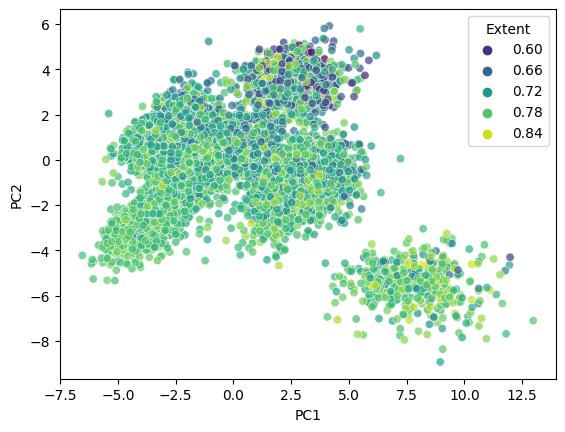

In [197]:
pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca['Extent'] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)
X_test_pca['Extent'] = df_imputed_missing['Extent']

sns.scatterplot(pd.concat([X_pca,X_test_pca]), x='PC1', y='PC2', hue='Extent', palette='viridis', alpha=0.7)

## ShapeFactor6

<Axes: xlabel='PC1', ylabel='PC2'>

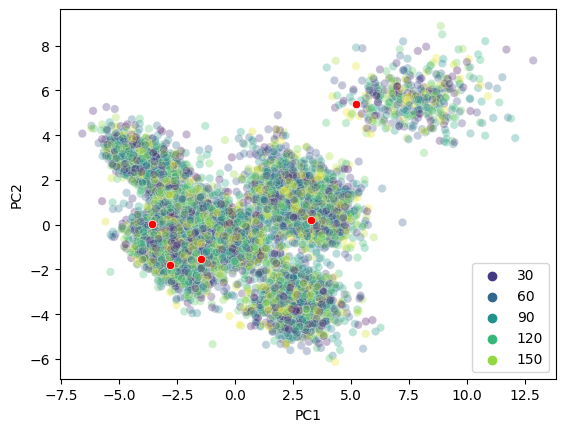

In [198]:
feature_of_interest = 'ShapeFactor6'
X = df_without_missing.drop(feature_of_interest, axis=1)
y = df_without_missing[feature_of_interest]

X_test = df_with_missing[df_with_missing[feature_of_interest].isna()].drop(['Colour_nan',feature_of_interest], axis=1)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_test_scaled = scaler.transform(X_test)

pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)
X_pca[feature_of_interest] = y

X_test_pca = pd.DataFrame(pca.transform(X_test_scaled), columns=['PC1', 'PC2'], index=X_test.index)

sns.scatterplot(X_pca, x='PC1', y='PC2', hue=feature_of_interest, palette='viridis', alpha=0.3)
sns.scatterplot(X_test_pca, x='PC1', y='PC2', c='red')

In [199]:
new_df_outliers_removed['Class'].value_counts()

Class
DERMASON    2814
SIRA        2104
SEKER       1637
HOROZ       1542
CALI        1307
BARBUNYA    1062
BOMBAY       414
Name: count, dtype: int64

In [200]:
new_df_outliers_removed[new_df_outliers_removed['ShapeFactor6'].isna()]['Class']

2881    DERMASON
3417    DERMASON
4239    DERMASON
4257        CALI
4258      BOMBAY
Name: Class, dtype: object

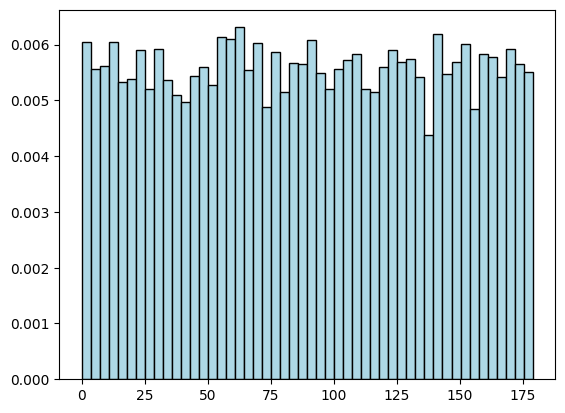

In [201]:
plt.hist(new_df_outliers_removed['ShapeFactor6'], density=True, bins=50, color="lightblue", edgecolor="black")
plt.show()

In [202]:
cor = new_df.corr()

In [203]:
cor['ShapeFactor6'].sort_values()

Compactness       -0.016637
ShapeFactor3      -0.015986
ShapeFactor2      -0.011300
ShapeFactor5      -0.008494
roundness         -0.008163
Extent            -0.003315
Colour_black      -0.002927
ShapeFactor4      -0.002324
Solidity          -0.002235
Class             -0.002220
Colour_green      -0.001910
Colour_nan        -0.000364
MinorAxisLength    0.000054
Colour_brown       0.001507
ShapeFactor1       0.002549
Constantness       0.002885
Colour_white       0.003506
EquivDiameter      0.005549
ConvexArea         0.006036
Area               0.006084
Perimeter          0.006215
MajorAxisLength    0.009998
AspectRation       0.015088
Eccentricity       0.015992
ShapeFactor6       1.000000
Name: ShapeFactor6, dtype: float64

In [204]:
#df_reduced_without_missing = df_without_missing.drop('ShapeFactor6', axis=1)
#df_reduced_imputed = df_imputed_missing.drop('ShapeFactor6', axis=1)

In [205]:
df_reduced_without_missing = df_without_missing.copy()
df_reduced_imputed = df_imputed_missing.copy()

In [206]:
df_reduced_imputed.loc[df_reduced_imputed['ShapeFactor6'].isna(), 'ShapeFactor6'] = df_reduced_without_missing['ShapeFactor6'].median()

## Creating new Dataset combining imputed values

In [207]:
new_df_after_missing_vals = pd.concat([df_reduced_without_missing, df_reduced_imputed])

In [208]:
new_df_after_missing_vals.shape

(10880, 24)

In [209]:
new_df_after_missing_vals.isna().sum()

Area               0
Perimeter          0
MajorAxisLength    0
MinorAxisLength    0
AspectRation       0
Eccentricity       0
ConvexArea         0
Constantness       0
EquivDiameter      0
Extent             0
Solidity           0
roundness          0
Compactness        0
ShapeFactor1       0
ShapeFactor2       0
ShapeFactor3       0
ShapeFactor4       0
ShapeFactor5       0
ShapeFactor6       0
Class              0
Colour_black       0
Colour_brown       0
Colour_green       0
Colour_white       0
dtype: int64

In [210]:
new_df_after_missing_vals.head(3)

,Area,Perimeter,MajorAxisLength,MinorAxisLength,AspectRation,Eccentricity,ConvexArea,Constantness,EquivDiameter,Extent,...,ShapeFactor2,ShapeFactor3,ShapeFactor4,ShapeFactor5,ShapeFactor6,Class,Colour_black,Colour_brown,Colour_green,Colour_white
3479,43159,782.565,282.242410,195.095726,1.446687,0.722630,43661,1,234.417887,0.753251,...,0.001920,0.689822,0.953606,0.997956,54.167078,6.0,0,1,0,0
11938,37826,704.225,242.586215,198.865740,1.219849,0.572688,38170,0,219.457420,0.764532,...,0.002650,0.818405,2.024259,0.998331,33.627907,5.0,0,0,1,0
6110,30180,639.114,237.364208,162.351296,1.462041,0.729505,30533,1,196.026451,0.745553,...,0.002257,0.682023,1.591614,0.997145,93.600673,3.0,1,0,0,0


## Noise

In [211]:
X = new_df_after_missing_vals.drop('Class', axis=1)
y = new_df_after_missing_vals['Class']

In [212]:
scaler_og = StandardScaler()
X_scaled = scaler_og.fit_transform(X)

In [213]:
pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)

<Axes: xlabel='PC1', ylabel='PC2'>

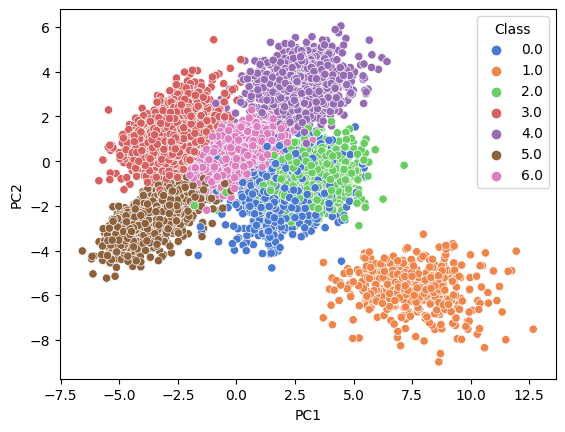

In [214]:
sns.scatterplot(X_pca, x='PC1', y='PC2', hue=y, palette='muted')

Class 1 seems seperated from the rest, however, the other classes, especially 0 and 2 contain noisy observations, with a lot of overlap. It seems like this in 2D, lets check if this persists in 3 dimensions.

In [215]:
pca = PCA(n_components=3)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2', 'PC3'], index=X.index)

fig = px.scatter_3d(X_pca, x='PC1', y='PC2', z='PC3', color=y, title='3D PCA Scatter Plot', labels={'color': 'Class'})

fig.show()

# OPTIONAL CODE!!!!

## Multicolinearity

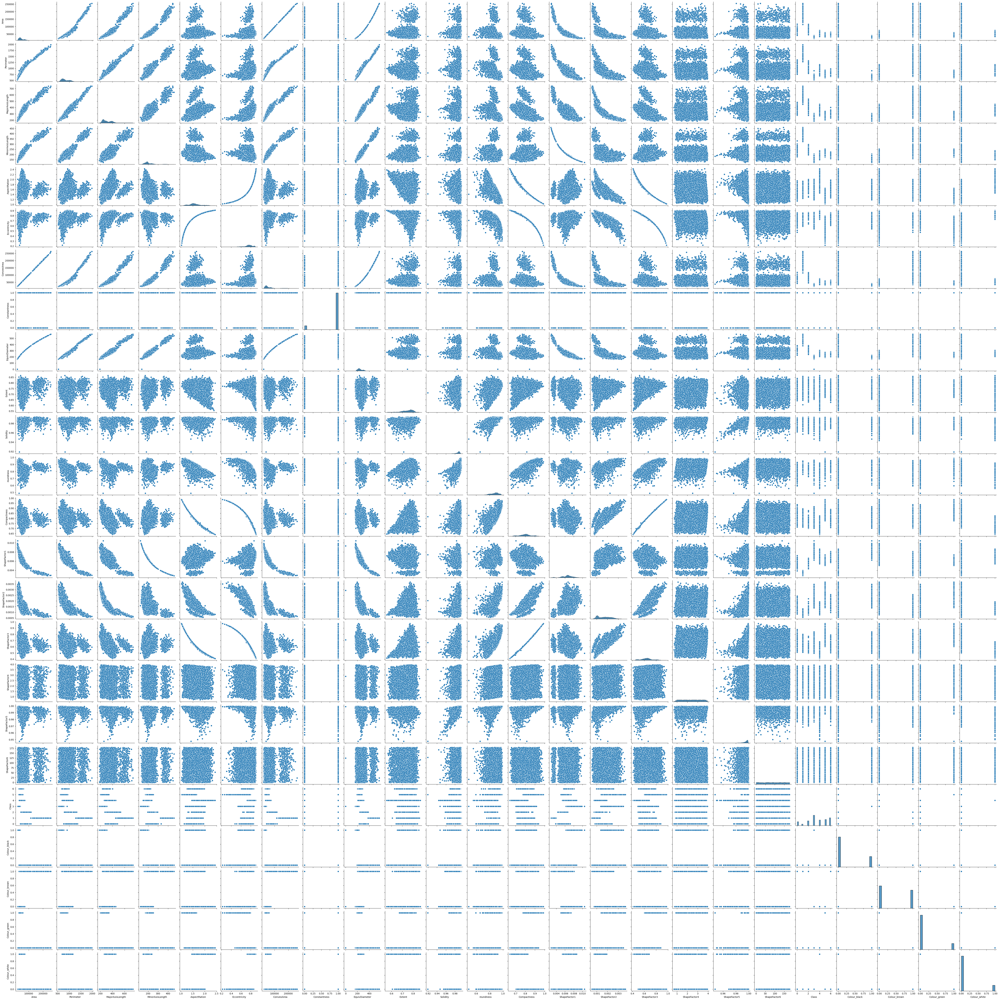

In [ ]:
sns.pairplot(new_df_after_missing_vals)

In [216]:
new_df_after_missing_vals.shape

(10880, 24)

In [217]:
cor = new_df_after_missing_vals.corr()

<Axes: >

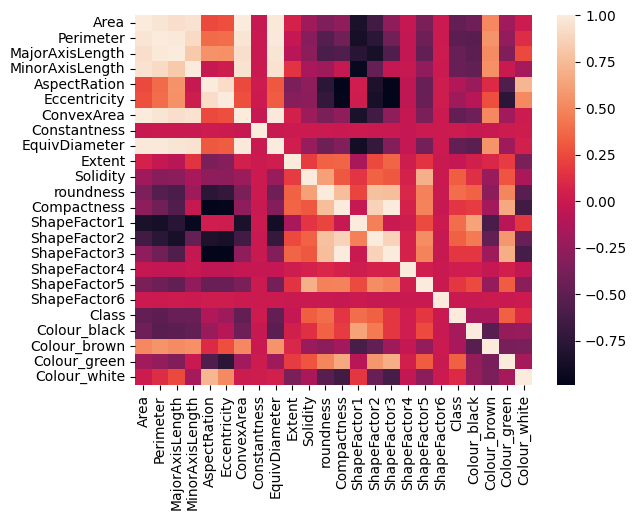

In [218]:
sns.heatmap(cor)

In [286]:
threshold = 0.95
cor_abs = cor.abs()

high_corr_pairs = np.where(cor_abs > threshold)
high_corr_pairs = [(cor.index[x], cor.columns[y], cor.iloc[x, y]) 
                   for x, y in zip(*high_corr_pairs) if x != y and x < y]

print("Highly correlated feature pairs:")
for pair in high_corr_pairs:
    print(f"{pair[0]} and {pair[1]} with correlation: {pair[2]:.3f}")

Highly correlated feature pairs:
Area and Perimeter with correlation: 0.967
Area and MinorAxisLength with correlation: 0.951
Area and ConvexArea with correlation: 1.000
Area and EquivDiameter with correlation: 0.984
Perimeter and MajorAxisLength with correlation: 0.977
Perimeter and ConvexArea with correlation: 0.967
Perimeter and EquivDiameter with correlation: 0.991
MajorAxisLength and EquivDiameter with correlation: 0.961
MinorAxisLength and ConvexArea with correlation: 0.951
AspectRation and Compactness with correlation: -0.988
AspectRation and ShapeFactor3 with correlation: -0.979
Eccentricity and Compactness with correlation: -0.970
Eccentricity and ShapeFactor3 with correlation: -0.981
ConvexArea and EquivDiameter with correlation: 0.985
Compactness and ShapeFactor3 with correlation: 0.999


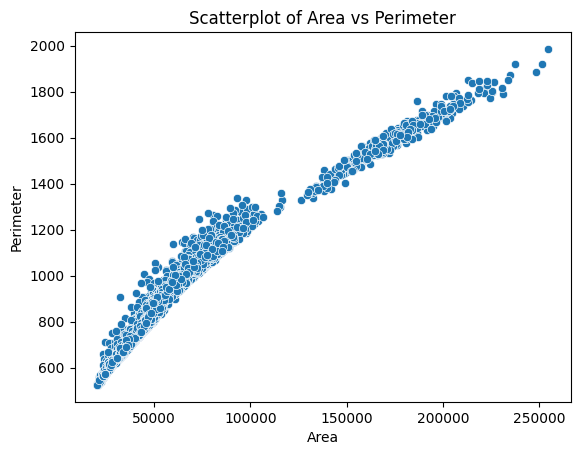

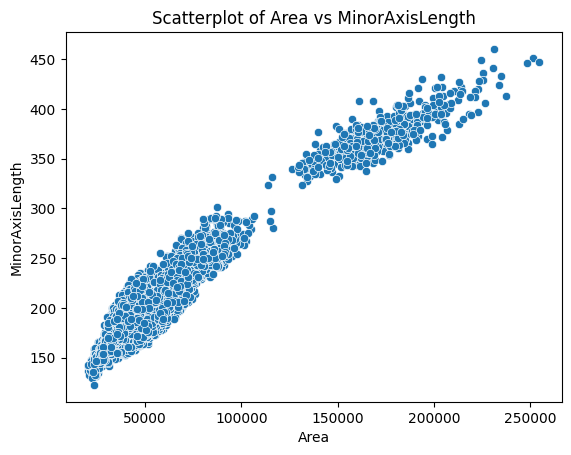

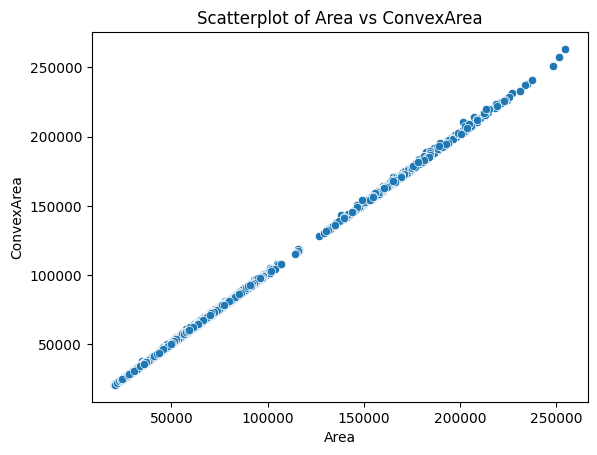

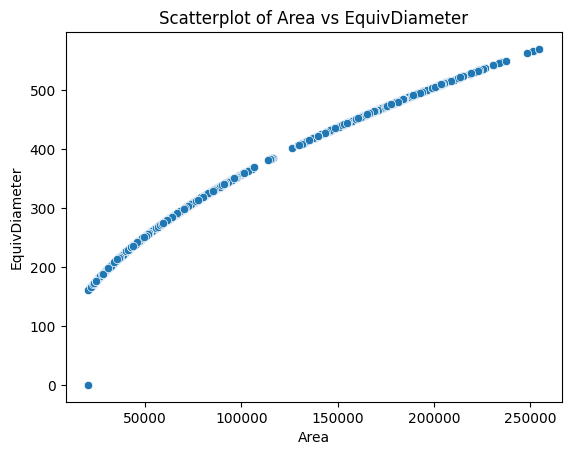

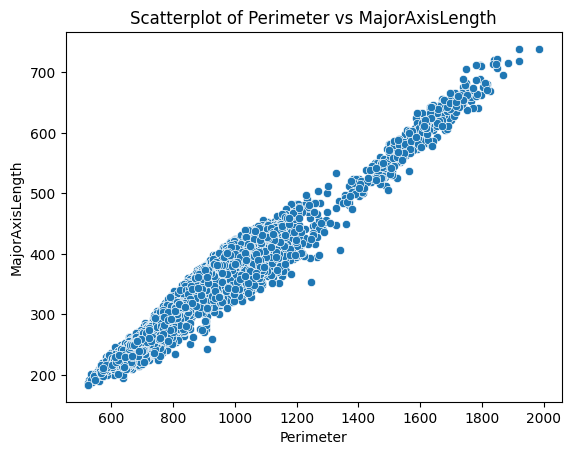

...

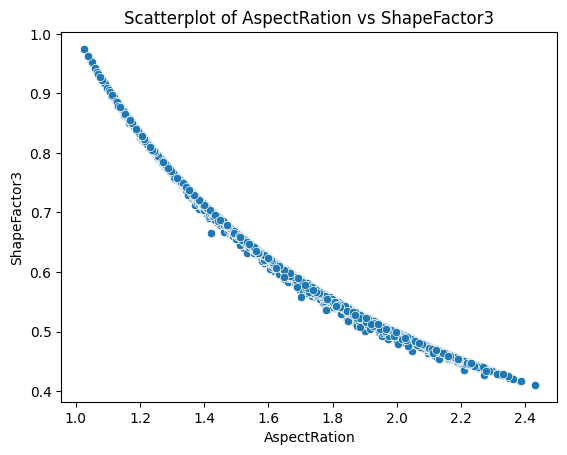

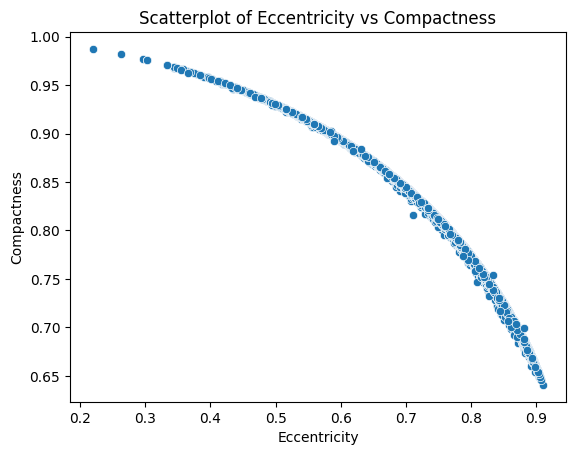

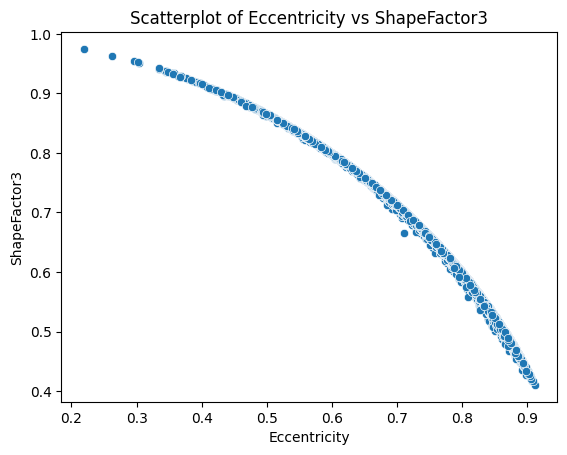

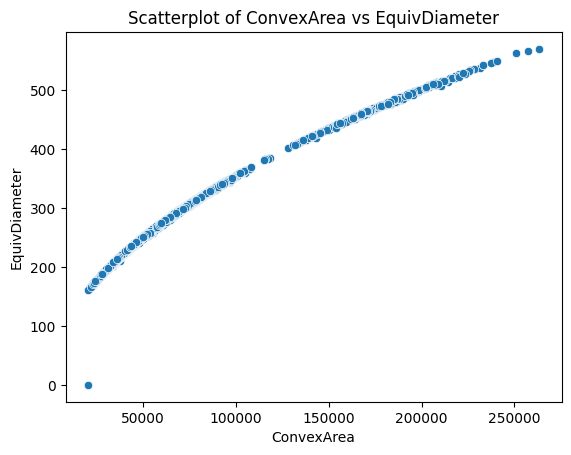

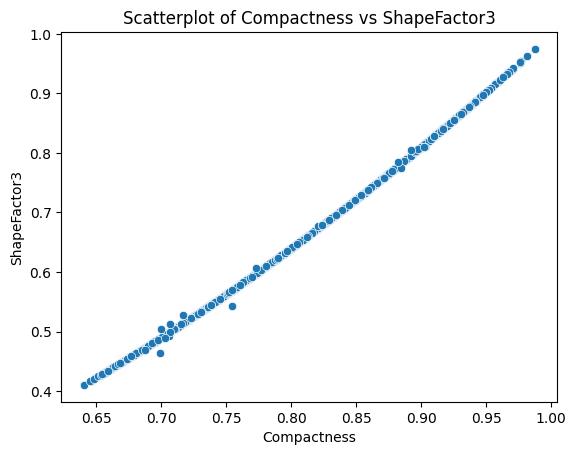

In [220]:
for feature_pair in high_corr_pairs:
    sns.scatterplot(x=new_df_after_missing_vals[feature_pair[0]], 
                    y=new_df_after_missing_vals[feature_pair[1]])
    plt.title(f'Scatterplot of {feature_pair[0]} vs {feature_pair[1]}')
    plt.xlabel(feature_pair[0])
    plt.ylabel(feature_pair[1])
    plt.show()

In [221]:
columns_to_drop = set()

for pair in high_corr_pairs:
    columns_to_drop.add(pair[1])

new_df_after_missing_vals = new_df_after_missing_vals.drop(columns=columns_to_drop)

print(f"Columns dropped: {columns_to_drop}")

Columns dropped: {'EquivDiameter', 'ConvexArea', 'MajorAxisLength', 'Perimeter', 'MinorAxisLength', 'Compactness', 'ShapeFactor3'}


In [222]:
new_df_after_missing_vals.shape

(10880, 17)

# OPTIONAL CODE!!!!

## Class imbalance

In [287]:
new_df_after_missing_vals.shape

(10880, 17)

In [288]:
new_df_after_missing_vals['Class'].value_counts().sort_index()

Class
0.0    1062
1.0     414
2.0    1307
3.0    2814
4.0    1542
5.0    1637
6.0    2104
Name: count, dtype: int64

In [ ]:
X = new_df_after_missing_vals.drop('Class', axis=1)
y = new_df_after_missing_vals['Class']

In [ ]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

In [ ]:
pca = PCA(n_components=0.95)
X_pca = pca.fit_transform(X_scaled)

In [ ]:
smote = SMOTE(random_state=42)
X_resampled_pca, y_resampled_pca = smote.fit_resample(X_pca, y)

In [ ]:
X_resampled_original = pca.inverse_transform(X_resampled_pca)
X_resampled_final = scaler.inverse_transform(X_resampled_original)

In [ ]:
new_df_balanced = pd.concat([pd.DataFrame(X_resampled_final, columns=X.columns), pd.DataFrame(y_resampled_pca, columns=['Class'])], axis=1)

In [ ]:
new_df_balanced['Class'].value_counts()

In [ ]:
pca_3d = PCA(n_components=3)
X_pca_3d = pca_3d.fit_transform(X_resampled_final)

fig = go.Figure(data=[go.Scatter3d(
    x=X_pca_3d[:, 0],
    y=X_pca_3d[:, 1],
    z=X_pca_3d[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color=y_resampled_pca,  
        colorscale='Viridis',    
        opacity=0.8
    )
)])

fig.update_layout(
    scene=dict(
        xaxis_title='Principal Component 1',
        yaxis_title='Principal Component 2',
        zaxis_title='Principal Component 3'
    ),
    title="Interactive 3D PCA Visualization of Resampled Data"
)

fig.show()

In [ ]:
new_df_after_missing_vals = new_df_balanced.copy()

# OPTIONAL CODE!!!!

### Tomek Link Noise Removal

In [ ]:
subset_df = new_df_after_missing_vals[new_df_after_missing_vals['Class'].isin([0, 2, 3, 6])]

In [ ]:
X = subset_df.drop(columns=['Class'])
y = subset_df['Class']

In [ ]:
tomek = TomekLinks(sampling_strategy='auto')
X_resampled, y_resampled = tomek.fit_resample(X, y)

In [ ]:
non_filtered_classes = new_df_after_missing_vals[~new_df_after_missing_vals['Class'].isin([0, 2, 3, 6])]

subset_cleaned = pd.concat([X_resampled, y_resampled], axis=1)
final_df = pd.concat([subset_cleaned, non_filtered_classes], ignore_index=True)

In [ ]:
print("Original dataset shape:", new_df_after_missing_vals.shape)
print("Cleaned dataset shape:", final_df.shape)

In [ ]:
X = final_df.drop('Class', axis=1)
y = final_df['Class']

In [ ]:
scaler_og = StandardScaler()
X_scaled = scaler_og.fit_transform(X)

In [ ]:
pca = PCA(n_components=2)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2'], index=X.index)

In [ ]:
sns.scatterplot(X_pca, x='PC1', y='PC2', hue=y, palette='muted')

Class 1 seems seperated from the rest, however, the other classes, especially 0 and 2 contain noisy observations, with a lot of overlap. It seems like this in 2D, lets check if this persists in 3 dimensions.

In [ ]:
pca = PCA(n_components=3)
X_pca = pd.DataFrame(pca.fit_transform(X_scaled), columns=['PC1', 'PC2', 'PC3'], index=X.index)

fig = px.scatter_3d(X_pca, x='PC1', y='PC2', z='PC3', color=y, title='3D PCA Scatter Plot', labels={'color': 'Class'})

fig.show()

In [ ]:
new_df_after_missing_vals = final_df.copy()

## 6. Modelling

## Classification Tree
Used scikitlearn's classification tree model. This model does not handle missing values like the C4.5 algorithm, therefore the missing values were imputed. The data does not need to be scaled for the decision tree. This makes interpretation of the predictions easier.

#### Training

In [290]:
new_df_after_missing_vals.head(3)

,Area,AspectRation,Eccentricity,Constantness,Extent,Solidity,roundness,ShapeFactor1,ShapeFactor2,ShapeFactor4,ShapeFactor5,ShapeFactor6,Class,Colour_black,Colour_brown,Colour_green,Colour_white
3479,43159,1.446687,0.722630,1,0.753251,0.988502,0.885606,0.006540,0.001920,0.953606,0.997956,54.167078,6.0,0,1,0,0
11938,37826,1.219849,0.572688,0,0.764532,0.990988,0.958468,0.006413,0.002650,2.024259,0.998331,33.627907,5.0,0,0,1,0
6110,30180,1.462041,0.729505,1,0.745553,0.988439,0.928480,0.007865,0.002257,1.591614,0.997145,93.600673,3.0,1,0,0,0


In [291]:
tree = DecisionTreeClassifier(random_state=42)

In [292]:
X_train = new_df_after_missing_vals.drop('Class', axis=1)
y_train = new_df_after_missing_vals['Class']

In [293]:
tree.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

In [294]:
test_df.drop('Sort order', axis=1, inplace=True)
#test_df.drop('ShapeFactor6', axis=1, inplace=True)

test_df['Class'] = le.transform(test_df['Class'])
test_df = pd.get_dummies(test_df, columns=['Colour'], dtype='int')

KeyError: "['Sort order'] not found in axis"

In [297]:
X_test = test_df[X_train.columns]
y_test = test_df['Class']

In [298]:
X_test.columns == X_train.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True])

In [299]:
y_pred = tree.predict(X_test)

In [300]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.91      0.91      0.91       254
           1       1.00      0.99      1.00       107
           2       0.95      0.93      0.94       321
           3       1.00      1.00      1.00       728
           4       1.00      1.00      1.00       385
           5       1.00      1.00      1.00       388
           6       0.97      0.99      0.98       529

    accuracy                           0.98      2712
   macro avg       0.97      0.97      0.97      2712
weighted avg       0.98      0.98      0.98      2712



In [301]:
print(accuracy_score(y_test, y_pred))

0.9793510324483776


In [302]:
new_df_after_missing_vals.corr()['Class'].sort_values()

Area           -0.476076
Eccentricity   -0.201470
Colour_black   -0.172241
Colour_brown   -0.163282
AspectRation   -0.118063
Extent         -0.031454
ShapeFactor6   -0.002218
Constantness    0.010511
ShapeFactor4    0.027573
Colour_white    0.103522
ShapeFactor5    0.163447
Solidity        0.326382
ShapeFactor2    0.335756
Colour_green    0.337141
roundness       0.387382
ShapeFactor1    0.392186
Class           1.000000
Name: Class, dtype: float64

In [303]:
X_train.shape[0]/20

544.0

In [311]:
X_train.shape

(10880, 16)

In [304]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10, 20, 30, 40, 50],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8],
    'ccp_alpha': np.linspace(0, 0.1, 5)
}

dt = DecisionTreeClassifier(random_state=42)

grid_search = GridSearchCV(estimator=dt, param_grid=param_grid, cv=20, scoring='accuracy', n_jobs=-1)

grid_search.fit(X_train, y_train)

print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best cross-validation accuracy: {grid_search.best_score_:.4f}")

Best parameters found: {'ccp_alpha': 0.0, 'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 10}
Best cross-validation accuracy: 0.9823


In [305]:
param_grid

{'criterion': ['gini', 'entropy'],
 'max_depth': [None, 10, 20, 30, 40, 50],
 'min_samples_split': [2, 5, 10, 20],
 'min_samples_leaf': [1, 2, 4, 8],
 'ccp_alpha': array([0.   , 0.025, 0.05 , 0.075, 0.1  ])}

In [306]:
print(grid_search.best_params_)

{'ccp_alpha': 0.0, 'criterion': 'gini', 'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 10}


#### Best model's performance on val set

In [241]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)

In [242]:
tree = DecisionTreeClassifier(criterion='gini', max_depth=10, min_samples_leaf=1, min_samples_split=10, ccp_alpha=0)
tree.fit(X_train, y_train)

DecisionTreeClassifier(ccp_alpha=0, max_depth=10, min_samples_split=10)

In [243]:
y_pred = tree.predict(X_val)

In [244]:
print(accuracy_score(y_val, y_pred))

0.9724296381390006


In [245]:
print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.95      0.82      0.88       191
         1.0       0.99      1.00      0.99        67
         2.0       0.85      0.98      0.91       191
         3.0       1.00      1.00      1.00       441
         4.0       1.00      1.00      1.00       250
         5.0       1.00      1.00      1.00       253
         6.0       0.98      0.97      0.98       348

    accuracy                           0.97      1741
   macro avg       0.97      0.97      0.97      1741
weighted avg       0.97      0.97      0.97      1741



## k-Nearest Neighbours

### Feature Selection

In [246]:
X = new_df_after_missing_vals.drop('Class', axis=1)
y = new_df_after_missing_vals['Class']

#### Backward Stepwise Selection

In [247]:
knn = KNeighborsClassifier()
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('knn', knn)
])

remaining_features = X.columns.tolist()
best_score = 0
best_features = remaining_features.copy()


while len(remaining_features) > 1:
    scores = []
    for feature in remaining_features:
        temp_features = [f for f in remaining_features if f != feature]
        X_temp = X[temp_features]
        

        if len(temp_features) > 0:
            score = np.mean(cross_val_score(pipeline, X_temp, y, cv=StratifiedKFold(10), scoring='accuracy'))
            scores.append((score, feature))
    
    scores.sort(reverse=True)
    best_new_score, worst_feature = scores[0]
    
    if best_new_score > best_score:
        best_score = best_new_score
        remaining_features.remove(worst_feature)
        best_features = remaining_features.copy()
        print(f"Removed feature: {worst_feature}, Best score: {best_score}")
    else:
        break  

print(f"Best score: {best_score}")
print("Selected features:", best_features)

Removed feature: ShapeFactor6, Best score: 0.9825367647058825
Removed feature: ShapeFactor4, Best score: 0.9849264705882355
Removed feature: Extent, Best score: 0.986672794117647
Removed feature: ShapeFactor2, Best score: 0.9867647058823529
Removed feature: Eccentricity, Best score: 0.9868566176470589
Removed feature: Constantness, Best score: 0.9869485294117645
Best score: 0.9869485294117645
Selected features: ['Area', 'AspectRation', 'Solidity', 'roundness', 'ShapeFactor1', 'ShapeFactor5', 'Colour_black', 'Colour_brown', 'Colour_green', 'Colour_white']


In [248]:
len(best_features)

10

### Without dimension reduction

In [249]:
X = new_df_after_missing_vals.drop('Class', axis=1)[best_features]
y = new_df_after_missing_vals['Class']

In [250]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('knn', KNeighborsClassifier())
])

In [251]:
param_grid = {
    'knn__n_neighbors': [3, 5, 7, 9, 11, 13, 15],
    'knn__weights': ['uniform', 'distance'],
    'knn__p': [1, 2]
}

In [252]:
grid_search = GridSearchCV(pipeline, param_grid, cv=20, scoring='accuracy', n_jobs=-1, verbose=2)
grid_search.fit(X, y)

Fitting 20 folds for each of 28 candidates, totalling 560 fits


GridSearchCV(cv=20,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'knn__n_neighbors': [3, 5, 7, 9, 11, 13, 15],
                         'knn__p': [1, 2],
                         'knn__weights': ['uniform', 'distance']},
             scoring='accuracy', verbose=2)

In [253]:
print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best cross-validation accuracy: {grid_search.best_score_:.4f}")

Best parameters found: {'knn__n_neighbors': 7, 'knn__p': 2, 'knn__weights': 'distance'}
Best cross-validation accuracy: 0.9880


### With dimension reduction

In [259]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),  
    ('pca', PCA()),  
    ('knn', KNeighborsClassifier()) 
])

In [260]:
param_grid = {
    #'pca__n_components': [5, 10, 15, 20, 25, 30], 
    'pca__n_components': [2, 5, 7, 8, 9, 10], 
    'knn__n_neighbors': [3, 5, 7, 9, 11, 13, 15],
    'knn__weights': ['uniform', 'distance'],
    'knn__p': [1, 2] 
}

In [261]:
grid_search = GridSearchCV(pipeline, param_grid, cv=20, scoring='accuracy', n_jobs=-1, verbose=2)
grid_search.fit(X, y)

Fitting 20 folds for each of 336 candidates, totalling 6720 fits
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_n

[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8;

[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=5; tot

[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_com

[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=

[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=13, knn__p=2, knn__weights=distance, pca__n_com

[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=15, knn__p=1, knn__weights=distance, pca__n_components

[CV] END knn__n_neighbors=3, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=3, knn__weights=uniform, pca__n_components=9; tot

[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=3, knn__p=4, knn__weights=distance, pca__n_components=9;

[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=uniform, pca__n_components=7; total tim

[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=10; total 

[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=10; total time=   0.1s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=10; total time=   0.1s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=10; tot

[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=3, knn__weights=uniform, pca__n_components=2; total tim

[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=5, knn__p=1, knn__weights=distance, pca__n_components=7;

[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=2; t

[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=1, knn__weights=distance, pca__n_components=8;

[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total tim

[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=2, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=9; total time=   0.1s
[CV] END knn__n_neighbors=7, knn__p=3, knn__weights=uniform, pca__n_components=9; total 

[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=1, knn__weights=uniform, pca__n_components=9; total tim

[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8; total time=   0.0s
[CV] END knn__n_neighbors=7, knn__p=4, knn__weights=distance, pca__n_components=8;

[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=9, knn__p=4, knn__weights=distance, pca__n_components=9;

[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_components=10; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=uniform, pca__n_componen

[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=uniform, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=2, knn__weights=distance, pca__n_components=

[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=3, knn__weights=distance, pca__n_components=9; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=4, knn__weights=distance, pca__n_components=5; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=4, knn__weights=distance, pca__n_com

[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=2; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_components=7; total time=   0.0s
[CV] END knn__n_neighbors=11, knn__p=1, knn__weights=distance, pca__n_com

GridSearchCV(cv=20,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('knn', KNeighborsClassifier())]),
             n_jobs=-1,
             param_grid={'knn__n_neighbors': [3, 5, 7, 9, 11, 13, 15],
                         'knn__p': [1, 2, 3, 4],
                         'knn__weights': ['uniform', 'distance'],
                         'pca__n_components': [2, 5, 7, 8, 9, 10]},
             scoring='accuracy', verbose=2)

In [262]:
print(f"Best parameters found: {grid_search.best_params_}")
print(f"Best cross-validation accuracy: {grid_search.best_score_:.4f}")

Best parameters found: {'knn__n_neighbors': 7, 'knn__p': 2, 'knn__weights': 'distance', 'pca__n_components': 9}
Best cross-validation accuracy: 0.9880


#### Best model's performance on val set

In [263]:
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)

In [264]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', PCA(n_components=9)),
    ('knn', KNeighborsClassifier(n_neighbors=7, weights='uniform', p=2))
])

In [265]:
pipeline.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA(n_components=9)),
                ('knn', KNeighborsClassifier(n_neighbors=7))])

In [266]:
y_pred = pipeline.predict(X_val)

In [267]:
print(accuracy_score(y_val, y_pred))

0.9866727941176471


In [268]:
print(classification_report(y_val, y_pred))

              precision    recall  f1-score   support

         0.0       0.97      0.93      0.95       214
         1.0       1.00      1.00      1.00        83
         2.0       0.93      0.98      0.95       252
         3.0       1.00      1.00      1.00       587
         4.0       1.00      1.00      1.00       303
         5.0       1.00      1.00      1.00       311
         6.0       0.99      0.98      0.99       426

    accuracy                           0.99      2176
   macro avg       0.98      0.98      0.98      2176
weighted avg       0.99      0.99      0.99      2176



## Comparing models using Friedman test

In [269]:
best_tree = DecisionTreeClassifier(criterion='gini', max_depth=10, min_samples_leaf=1, min_samples_split=10, ccp_alpha=0)
best_knn = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', PCA(n_components=9)),
    ('knn', KNeighborsClassifier(n_neighbors=7, weights='uniform', p=2))
])

In [270]:
X = new_df_after_missing_vals.drop('Class', axis=1)
y = new_df_after_missing_vals['Class']

In [271]:
tree_scores = cross_val_score(best_tree, X, y, cv=30, scoring='accuracy')
knn_scores = cross_val_score(best_knn, X[best_features], y, cv=30, scoring='accuracy')

In [272]:
paired_differences = np.array(tree_scores) - np.array(knn_scores)

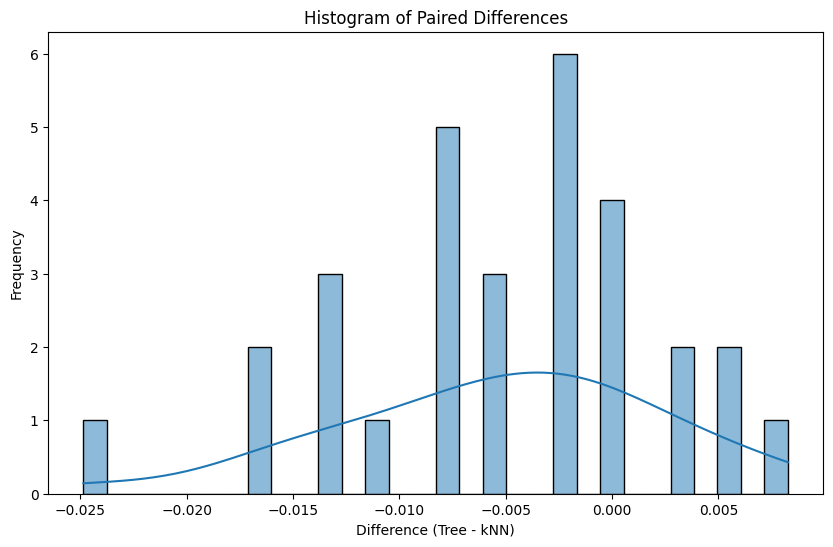

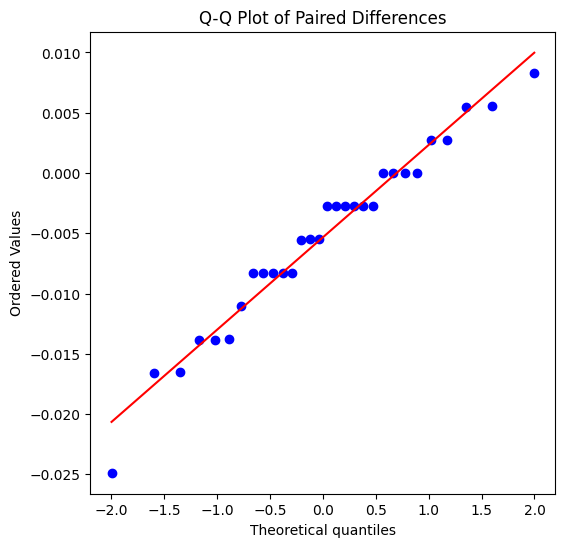

In [273]:
plt.figure(figsize=(10, 6))
sns.histplot(paired_differences, kde=True, bins=30)
plt.title("Histogram of Paired Differences")
plt.xlabel("Difference (Tree - kNN)")
plt.ylabel("Frequency")
plt.show()

plt.figure(figsize=(6, 6))
stats.probplot(paired_differences, dist="norm", plot=plt)
plt.title("Q-Q Plot of Paired Differences")
plt.show()

In [274]:
u_stat, p_value = mannwhitneyu(tree_scores, knn_scores)
print(f"U-statistic: {u_stat}, P-value: {p_value}")

U-statistic: 302.5, P-value: 0.028875469566352178


In [275]:
from scipy.stats import ttest_ind
t_stat, p_value = ttest_ind(tree_scores, knn_scores, equal_var=True)
print(f"T-statistic: {t_stat}, P-value: {p_value}")

T-statistic: -2.8816230833848935, P-value: 0.005538210921860488


In [276]:
print(tree_scores.mean())
print(knn_scores.mean())

0.9825335220613977
0.9878678802084127


## Evaluating Generalisation Performance

In [316]:
X_test_subset = test_df[best_features]
y_test = test_df['Class']

In [317]:
X_train = new_df_after_missing_vals[best_features]
y_train = new_df_after_missing_vals['Class']

In [318]:
best_knn.fit(X_train, y_train)

Pipeline(steps=[('scaler', StandardScaler()), ('pca', PCA(n_components=9)),
                ('knn', KNeighborsClassifier(n_neighbors=7))])

In [319]:
y_pred = best_knn.predict(X_test_subset)

In [320]:
print(accuracy_score(y_test, y_pred))

0.9841445427728613


In [321]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.95      0.93      0.94       254
           1       1.00      1.00      1.00       107
           2       0.95      0.96      0.95       321
           3       1.00      1.00      1.00       728
           4       1.00      1.00      1.00       385
           5       1.00      1.00      1.00       388
           6       0.98      0.98      0.98       529

    accuracy                           0.98      2712
   macro avg       0.98      0.98      0.98      2712
weighted avg       0.98      0.98      0.98      2712



In [322]:
test_df.shape

(2712, 24)

In [323]:
df.shape

(10899, 22)

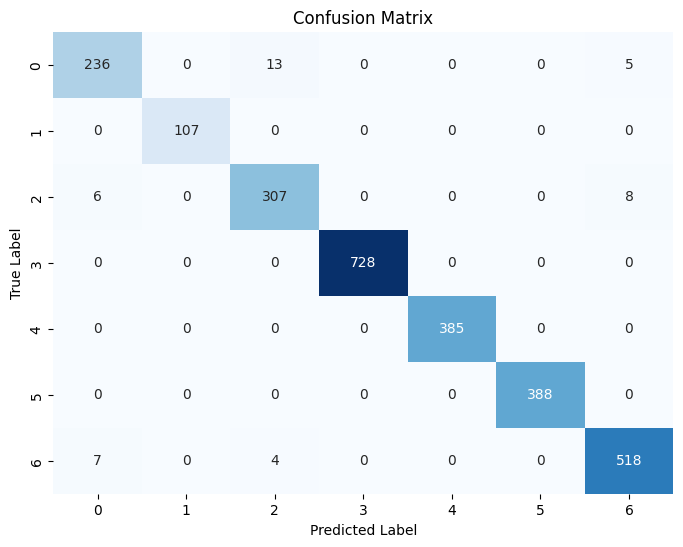

In [325]:
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()